In [155]:
# CSc 44700 - Intro to Machine Learning - Final Project - Butterfly Multiclass Image Classification Using CNN Model with ResNet50

# This project aims to develop an accurate and robust machine learning model that can identify and differentiate between
# various butterfly species from images, such as mimetic species. This project uses convolutional neural networks (CNNs) 
# on a dataset of about 1000+ butterfly images, with 75 different classes/labeled species of butterflies. This can further  
# help scientific and academic professionals classify different species of butterflies.

# This project can be broken down into the following sections: 

## 1. Data Exploration & Exploratory Data Analysis (EDA)
# - Class distribution of original dataset -- raw count of images per (predefined) class/label
# - Image size distribution of original dataset images
# - Split & reorganize dataset & prepare/preprocess for training
# - Class distribution of train & validation (training) sets

## 2. Training Process/Progress
# - Data transformations and data loaders for CNN normalization
# - Define the Simple CNN model: 16 epochs, Adam optimizer, batch size = 32, learning rate = 0.001, Cross-Entropy Loss function
# - Supervised training loop of the CNN model

## 3. Final Model Evaluation
# - Classification reports, confusion matrices, and batch accuracy visualizations
# - Analyses and visualizations for per-class precision, recall, F1-score, support

## 4. Qualitative Analysss on Predictions
# - Visualizations of class distributions among train, val, and test sets
# - Sample predictions on (unlabeled) test set 

## 5. Discussion & Conclusion

In [117]:
# import necessary libraries and packages
import numpy as np
import pandas as pd
import os
import shutil
from PIL import Image
from tqdm import tqdm

import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim.lr_scheduler import StepLR
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, models, datasets
from torchvision.datasets import ImageFolder

from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, precision_recall_fscore_support

import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import seaborn as sns

In [118]:
# Original Dataset: https://www.kaggle.com/datasets/phucthaiv02/butterfly-image-classification/data

## 1. The original dataset was downloaded as a zip file, then unzipped/extract all, and the resulting folder is hereby called 
#     the 'original' folder.

## 2. Two subfolders within the original, 'test' and 'train', contain predefined splits of .jpg images of various butterfly 
#     species.

## 3. Two files are within the original, 'Testing_set.csv' and 'Training_set.csv'. The training set CSV contains the butterfly 
#     classification of each image in its respective subfolder (ie. column header = ['filename', 'label']). The testing set 
#     CSV only has filenames -- no label or classification for these images (ie. column header = ['filename']) -- which can 
#     be a limitation for this ML project, since we can't validate the testing images.

## 4. To use PyTorch, we need to use the training CSV file to re-organize the images to within its individual subfolders 
#     (named with its respective label).

## 5. To undo the transformations made to the original downloaded dataset or to rerun this project from the start, you can 
#     delete the original folder and unzip/extract-all from the zipped folder.

In [119]:
# define dataset paths
original_dir = "./butterfly-image-classification"

train_csv = os.path.join(original_dir, "Training_set.csv")
test_csv = os.path.join(original_dir, "Testing_set.csv")
train_dir = os.path.join(original_dir, "train")
test_dir = os.path.join(original_dir, "test")

val_dir = os.path.join(original_dir, "val")
os.makedirs(val_dir, exist_ok=True)

# print dataset paths
print("train csv:", train_csv)
print("test csv:", test_csv)
print("train dir:", train_dir)
print("test dir:", test_dir)
print("val dir:", val_dir)

train csv: ./butterfly-image-classification\Training_set.csv
test csv: ./butterfly-image-classification\Testing_set.csv
train dir: ./butterfly-image-classification\train
test dir: ./butterfly-image-classification\test
val dir: ./butterfly-image-classification\val


In [120]:
# get testing CSV info -- num images, first 10 rows (test is an unlabeled set)
test_df = pd.read_csv(test_csv)
print("Number of Test Images:", len(test_df))
test_df.head(10)

Number of Test Images: 2786


,filename
0,Image_1.jpg
1,Image_2.jpg
2,Image_3.jpg
3,Image_4.jpg
4,Image_5.jpg
5,Image_6.jpg
6,Image_7.jpg
7,Image_8.jpg
8,Image_9.jpg
9,Image_10.jpg


In [121]:
# get training CSV info -- num images, num classes, class labels, first 10 rows, value counts (train is a labeled set)
train_df = pd.read_csv(train_csv)
print("Number of Training Images:", len(train_df))
num_classes = train_df["label"].nunique()
print("\nNumber of Predefined Classes:", num_classes)
list_classes = train_df["label"].unique()
print("\nList of Predefined Classes:", list_classes)
print("\nNum Images Per Class", train_df['label'].value_counts())
print("\n")
train_df.head(10)

Number of Training Images: 6499

Number of Predefined Classes: 75

List of Predefined Classes: ['SOUTHERN DOGFACE' 'ADONIS' 'BROWN SIPROETA' 'MONARCH'
 'GREEN CELLED CATTLEHEART' 'CAIRNS BIRDWING' 'EASTERN DAPPLE WHITE'
 'RED POSTMAN' 'MANGROVE SKIPPER' 'BLACK HAIRSTREAK' 'CABBAGE WHITE'
 'RED ADMIRAL' 'PAINTED LADY' 'PAPER KITE' 'SOOTYWING' 'PINE WHITE'
 'PEACOCK' 'CHECQUERED SKIPPER' 'JULIA' 'COMMON WOOD-NYMPH' 'BLUE MORPHO'
 'CLOUDED SULPHUR' 'STRAITED QUEEN' 'ORANGE OAKLEAF' 'PURPLISH COPPER'
 'ATALA' 'IPHICLUS SISTER' 'DANAID EGGFLY' 'LARGE MARBLE'
 'PIPEVINE SWALLOW' 'BLUE SPOTTED CROW' 'RED CRACKER' 'QUESTION MARK'
 'CRIMSON PATCH' 'BANDED PEACOCK' 'SCARCE SWALLOW' 'COPPER TAIL'
 'GREAT JAY' 'INDRA SWALLOW' 'VICEROY' 'MALACHITE' 'APPOLLO'
 'TWO BARRED FLASHER' 'MOURNING CLOAK' 'TROPICAL LEAFWING' 'POPINJAY'
 'ORANGE TIP' 'GOLD BANDED' 'BECKERS WHITE' 'RED SPOTTED PURPLE'
 'MILBERTS TORTOISESHELL' 'SILVER SPOT SKIPPER' 'AMERICAN SNOOT' 'AN 88'
 'ULYSES' 'COMMON BANDED AWL' 'CRECE

,filename,label
0,Image_1.jpg,SOUTHERN DOGFACE
1,Image_2.jpg,ADONIS
2,Image_3.jpg,BROWN SIPROETA
3,Image_4.jpg,MONARCH
4,Image_5.jpg,GREEN CELLED CATTLEHEART
5,Image_6.jpg,CAIRNS BIRDWING
6,Image_7.jpg,GREEN CELLED CATTLEHEART
7,Image_8.jpg,EASTERN DAPPLE WHITE
8,Image_9.jpg,BROWN SIPROETA
9,Image_10.jpg,RED POSTMAN


In [122]:
# EDA on original training dataset

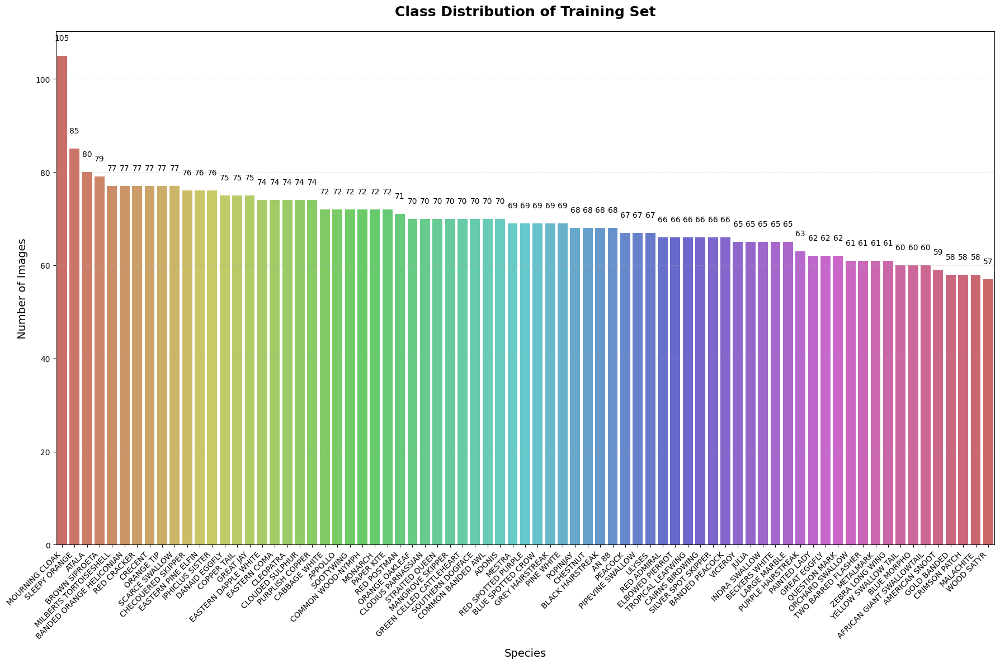

In [198]:
# visualize class distribution of training set

# color palette by class order (by count of images in each class/label)
class_order = train_df['label'].value_counts().index.tolist()
range_palette = sns.color_palette('hls', num_classes)
palette_dict = dict(zip(class_order, range_palette))

# plot class distribution
plt.figure(figsize=(18, 12))
ax = sns.countplot(x='label', hue='label', data=train_df, order=class_order, palette=palette_dict, legend=False)

# value labels
for patch in ax.patches:
    height = patch.get_height()
    if height > 0:
        ax.text(
            patch.get_x() + patch.get_width() / 2,
            height + 3,
            f'{int(height):,}',
            ha='center',
            va='bottom',
            fontsize=10
        )

plt.title('Class Distribution of Training Set', pad=20, fontsize=18, fontweight='bold')
plt.ylabel('Number of Images', labelpad=10, fontsize=14)
plt.xlabel('Species', labelpad=10, fontsize=14)
plt.xticks(rotation=45, ha='right', fontsize=10)
ax.yaxis.grid(True, linestyle='--', alpha=0.3)
plt.tight_layout()
plt.show()

In [124]:
# # visualize image size distribution of training set -- this can cause issues in preprocessing if outliers exist
# image_shapes = []
# for _, row in df.iterrows():
#     img_path = os.path.join(
#         train_dir, row['label'], row['filename']) if os.path.exists(os.path.join(train_dir, row['label'], row['filename'])) else os.path.join(train_dir, row['filename'])
#     if os.path.exists(img_path):
#         with Image.open(img_path) as img:
#             image_shapes.append({
#                 'label': row['label'],
#                 'width': img.width,
#                 'height': img.height
#             })

# shapes_df = pd.DataFrame(image_shapes)

In [125]:
# # violin plot: image widths by class/label 
# plt.figure(figsize=(12, 6))
# sns.violinplot(
#     x='label',
#     y='width',
#     hue='label',
#     data=shapes_df,
#     palette='Set2',
#     legend=False
# )
# plt.xticks(rotation=90)
# plt.title('Image Width Distribution by Class')
# plt.xlabel('Species')
# plt.ylabel('Image Width (pixels)')
# plt.tight_layout()
# plt.show()

In [126]:
# # violin plot: image heights by class/label 
# plt.figure(figsize=(12, 6))
# sns.violinplot(
#     x='label',
#     y='height',
#     hue='label',
#     data=shapes_df,
#     palette='Set2',
#     legend=False
# )
# plt.xticks(rotation=90)
# plt.title('Image Height Distribution by Class')
# plt.xlabel('Species')
# plt.ylabel('Image Height (pixels)')
# plt.tight_layout()
# plt.show()

In [127]:
# no visible distribution in image widths or heights (sizes), meaning no no outliers/spread/variation in image sizes

In [128]:
# because the test set has unlabeled images (can't validate), we can split the training set to: train and validate sets

In [129]:
# df = pd.read_csv(os.path.join(original_dir, "Training_set.csv"))
df = pd.read_csv(train_csv)

# split the training dataset into: train and validation (80-20 split)
train_df, val_df = train_test_split(
    df, test_size=0.2, stratify=df['label'], random_state=42
)

In [130]:
# PyTorch's ImageFolder requires images to be classified in subfolders (named with their 'label' column in the training CSV)

In [131]:
# move images to 'train' or 'val' based on split -- organize 'train' and 'val' images into labeled subfolders
def move_and_organize(df, source_dir, target_dir):
    for _, row in df.iterrows():
        label = row['label']
        filename = row['filename']
        src = os.path.join(source_dir, filename)
        dst_dir = os.path.join(target_dir, label)
        dst = os.path.join(dst_dir, filename)
        os.makedirs(dst_dir, exist_ok=True)
        if os.path.exists(src):
            shutil.move(src, dst)
        else:
            print(f"Warning: {src} does not exist.")

# move & organize images (using original training labels)
move_and_organize(train_df, train_dir, train_dir)
move_and_organize(val_df, train_dir, val_dir) 

In [132]:
## If you rerun, you may see errors if in a previous run, the function was called and already moved the images into its subfolder
## You can delete the 'butterfly-image-classification' folder and unzip/extract the 'butterfly-image-classification.zip' if needed, to rerun

In [133]:
# get all image paths
train_images = set()
for root, _, files in os.walk(train_dir):
    for f in files:
        if f.endswith(('.jpg')):
            train_images.add(f)

val_images = set()
for root, _, files in os.walk(val_dir):
    for f in files:
        if f.endswith(('.jpg')):
            val_images.add(f)

# verify 75 classes for 'train' and 'val', and num images per set
print(f"train: {len(os.listdir(train_dir))} classes")
print(f"val: {len(os.listdir(val_dir))} classes")

# print("\nNum Images Per Class", train_df['label'].value_counts())
print("\nNum Images in Each Split/Set:")
print("train:", sum(len(files) for _, _, files in os.walk(train_dir)))
print("val:", sum(len(files) for _, _, files in os.walk(val_dir)))

print(f"{len(train_images & val_images)} overlap")  # should be 0, prevent data leakage

train: 75 classes
val: 75 classes

Num Images in Each Split/Set:
train: 5199
val: 1300
0 overlap


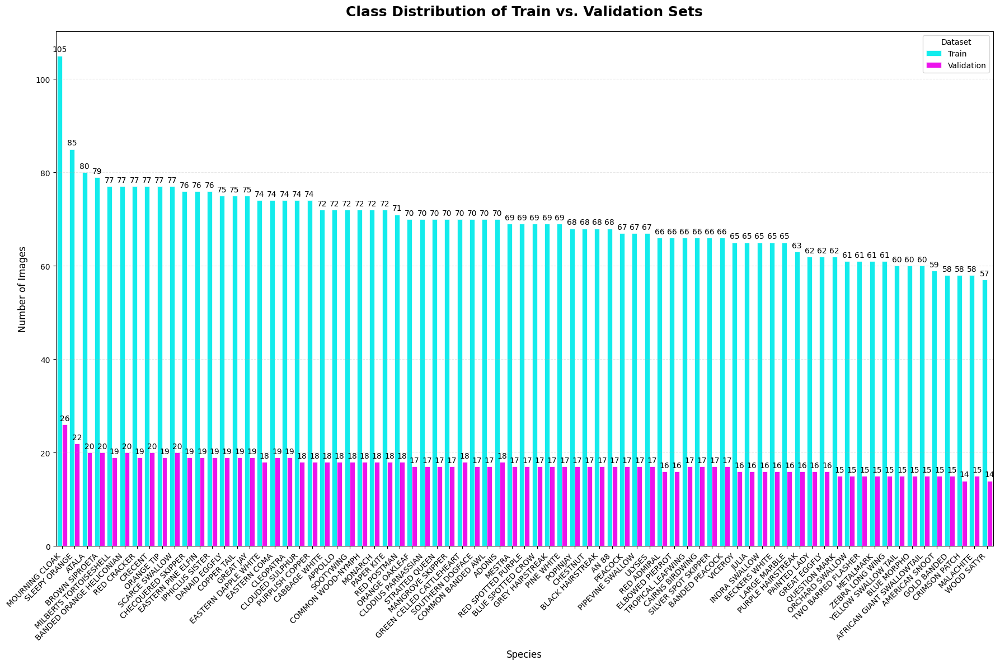

In [154]:
# visualize class distribution of the *new* train and validation sets (by count of images) -- split comparison
train_df['split'] = 'Train'
val_df['split'] = 'Validation'

train_val_df = pd.concat([train_df, val_df])
class_order = train_df['label'].value_counts().index

plt.figure(figsize=(18, 12))
ax = sns.countplot(
    x='label',
    hue='split',
    data=train_val_df,
    order=class_order,
    palette=['cyan', 'magenta'],
    saturation=0.85,
    linewidth=0.5,
    edgecolor="white"
)

# value labels
for container in ax.containers:
    labels = [
        f'{int(x):,}' if x > 0 else ''
        for x in container.datavalues
    ]
    ax.bar_label(
        container,
        labels=labels,
        label_type='edge',
        padding=3,
        fontsize=10,
    )

plt.title('Class Distribution of Train vs. Validation Sets', fontsize=18, fontweight='bold', pad=20)
plt.ylabel('Number of Images', fontsize=12, labelpad=10)
plt.xlabel('Species', fontsize=12, labelpad=10)
plt.xticks(rotation=45, ha='right')
ax.yaxis.grid(True, linestyle='--', alpha=0.3)
plt.legend(title='Dataset')
plt.tight_layout()
plt.show()

In [135]:
# define data transforms and loaders for CNN normalization -- helps prevent overfitting && makes model robust

In [136]:
# training-validation transforms, datasets & dataloaders
img_size = 128
batch_size = 32

# train transforms -- 
transform_train = transforms.Compose([
    transforms.Resize(int(img_size * 1.1)),
    transforms.RandomResizedCrop(img_size, scale=(0.8, 1.0)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(15),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.05),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# val transforms -- standard minimal, deterministic
transform_val = transforms.Compose([
    transforms.Resize(img_size + 16),
    transforms.CenterCrop(img_size),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

train_dataset = datasets.ImageFolder(train_dir, transform=transform_train)
val_dataset = datasets.ImageFolder(val_dir, transform=transform_val)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=0)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=0)

In [137]:
# visualize & confirm sample images and preprocessing

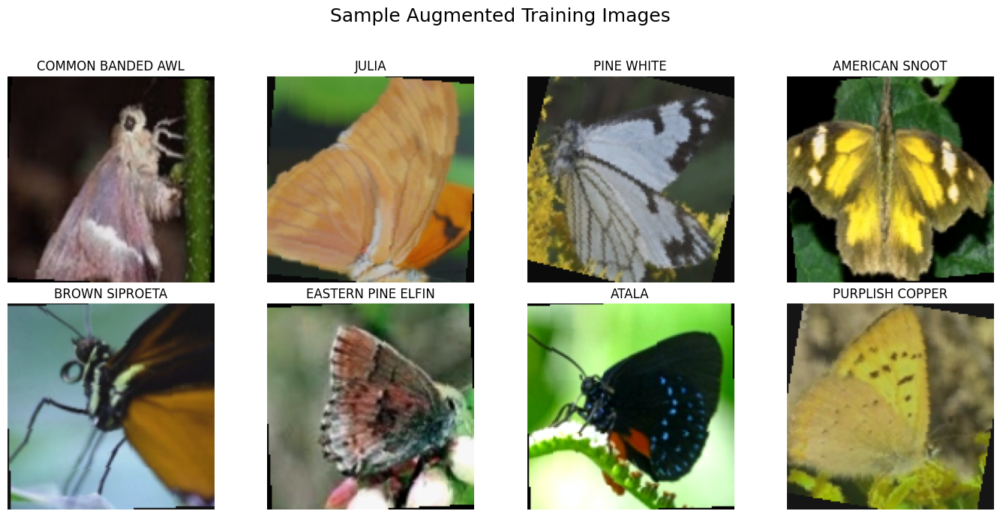

In [138]:
# visualize augmentations -- random samples after augmentations applied
def plot_augmentations(dataset, n_samples=8, class_names=None):
    plt.figure(figsize=(14, 7))
    for i in range(n_samples):
        img, label = dataset[np.random.randint(len(dataset))]
        # denormalize
        img = img.numpy().transpose(1,2,0)
        img = img * [0.229, 0.224, 0.225] + [0.485, 0.456, 0.406]
        img = np.clip(img, 0, 1)
        
        plt.subplot(2, 4, i+1)
        plt.imshow(img)
        if class_names is not None:
            plt.title(class_names[label], fontsize=12)
        else:
            plt.title(f"Class {label}", fontsize=12)
        plt.axis('off')
    plt.suptitle('Sample Augmented Training Images', fontsize=18)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

plot_augmentations(train_dataset, n_samples=8, class_names=train_dataset.classes)

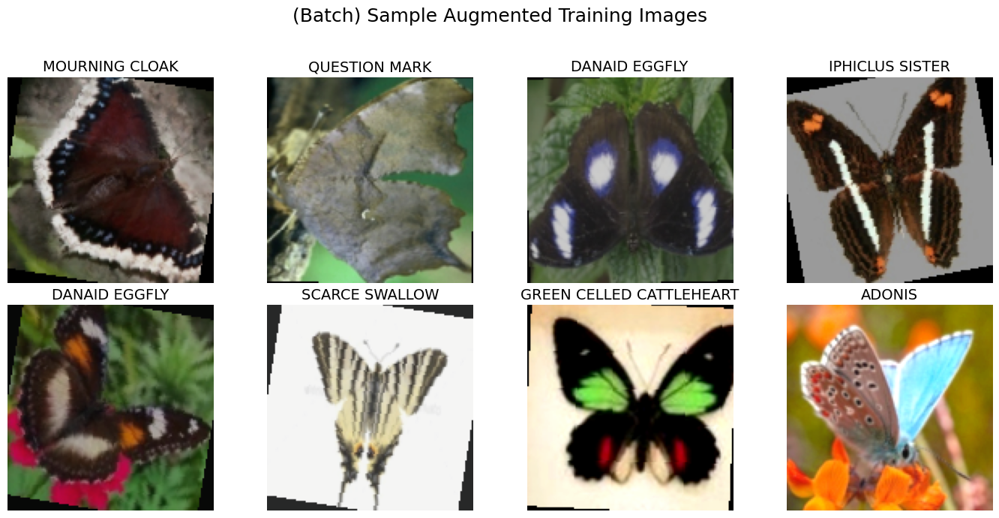

In [153]:
# show a batch of training data -- sample batch as they are loaded for training
images, labels = next(iter(train_loader))
plt.figure(figsize=(14,7))
for i in range(8):
    plt.subplot(2, 4, i+1)
    imshow(images[i], title=train_dataset.classes[labels[i]], title_fontsize=14)
plt.suptitle('(Batch) Sample Augmented Training Images', fontsize=18)
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

In [140]:
# supervised training loop using cross-entropy loss -- track the training loss and validation accuracy of the CNN model

In [156]:
# define CNN model
class SimpleButterflyCNN(nn.Module):
    def __init__(self, num_classes):
        super().__init__()
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, 3, padding=1),  # layer 1: 128x128 -> 128x128
            nn.ReLU(),
            nn.MaxPool2d(2),                 # 128x128 -> 64x64

            nn.Conv2d(32, 64, 3, padding=1), # layer 2: 64x64 -> 64x64
            nn.ReLU(),
            nn.MaxPool2d(2),                 # 64x64 -> 32x32

            nn.Conv2d(64, 128, 3, padding=1), # layer 3: 32x32 -> 32x32
            nn.ReLU(),
            nn.MaxPool2d(2),                 # 32x32 -> 16x16

            nn.Conv2d(128, 256, 3, padding=1), # layer 4: 32x32 -> 32x32
            nn.ReLU(),
            nn.MaxPool2d(2),                 # 16x16 -> 8x8
        )
        self.classifier = nn.Sequential(
            nn.Flatten(),
            nn.Linear(256*8*8, 256),
            nn.ReLU(),
            nn.Dropout(0.5),
            nn.Linear(256, num_classes)
        )

    def forward(self, x):
        x = self.features(x)
        x = self.classifier(x)
        return x

In [151]:
# SimpleButterflyCNN -- training loop & setup
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

num_classes = len(train_dataset.classes)
initial_lr = 0.001

# init SimpleButterflyCNN model
model = SimpleButterflyCNN(num_classes).to(device)

optimizer = optim.Adam(model.parameters(), lr=initial_lr)
criterion = nn.CrossEntropyLoss()
epochs = 20 # 32 max

# init trackers list for each epoch
train_losses = []
train_accs = []
val_losses = []
val_accs = []
all_labels = []
all_preds = []

# training loop
for epoch in range(epochs):
    
    total_steps = len(train_loader) + len(val_loader)
    with tqdm(total=total_steps, desc=f"Epoch {epoch+1}/{epochs}") as pbar:

        # for training
        model.train()
        running_loss = 0.0
        correct = 0
        total = 0
    
        # for each batch in traiing set
        for images, labels in tqdm(train_loader, desc=f"Epoch {epoch+1}/{epochs} [Train]"):
            images, labels = images.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
    
            # accuracy / correct predictions
            running_loss += loss.item() * images.size(0)
            _, preds = torch.max(outputs, 1)
            correct += (preds == labels).sum().item()
            total += labels.size(0)
            
            pbar.update(1)

        # train, validation metrics
        train_loss = running_loss / total
        train_acc = correct / total
        train_losses.append(train_loss)
        train_accs.append(train_acc)
    
        # for validation evaluation
        model.eval()
        val_loss = 0.0
        val_correct = 0
        val_total = 0
        epoch_labels = []
        epoch_preds = []
        
        with torch.no_grad():
            for images, labels in tqdm(val_loader, desc=f"Epoch {epoch+1}/{epochs} [Val]"):
                images, labels = images.to(device), labels.to(device)
                outputs = model(images)
                loss = criterion(outputs, labels)
                
                # validation accuracy / predictions
                val_loss += loss.item() * images.size(0)
                _, preds = torch.max(outputs, 1)
                val_correct += (preds == labels).sum().item()
                val_total += labels.size(0)
                epoch_labels.extend(labels.cpu().numpy())
                epoch_preds.extend(preds.cpu().numpy())
                
                pbar.update(1)
    
        val_loss /= val_total
        val_acc = val_correct / val_total
        val_losses.append(val_loss)
        val_accs.append(val_acc)
        all_labels.append(epoch_labels)
        all_preds.append(epoch_preds)
        
        print(f"Epoch {epoch+1}/{epochs} | "
              f"Train Loss: {train_loss:.4f} | Train Acc: {train_acc:.4f} | Val Acc: {val_acc:.4f} | Val Loss: {val_loss:.4f}")

Epoch 1/20 [Val]: 100%|████████████████████████████████████████████████████████████████| 41/41 [00:13<00:00,  3.09it/s]


Epoch 1/20 | Train Loss: 4.0465 | Train Acc: 0.0460 | Val Acc: 0.1715 | Val Loss: 3.3926


Epoch 2/20 [Val]: 100%|████████████████████████████████████████████████████████████████| 41/41 [00:12<00:00,  3.25it/s]


Epoch 2/20 | Train Loss: 3.3444 | Train Acc: 0.1566 | Val Acc: 0.2915 | Val Loss: 2.6959


Epoch 3/20 [Val]: 100%|████████████████████████████████████████████████████████████████| 41/41 [00:12<00:00,  3.25it/s]


Epoch 3/20 | Train Loss: 2.8868 | Train Acc: 0.2427 | Val Acc: 0.3738 | Val Loss: 2.4377


Epoch 4/20 [Val]: 100%|████████████████████████████████████████████████████████████████| 41/41 [00:12<00:00,  3.26it/s]


Epoch 4/20 | Train Loss: 2.5584 | Train Acc: 0.3129 | Val Acc: 0.4238 | Val Loss: 2.2100


Epoch 5/20 [Val]: 100%|████████████████████████████████████████████████████████████████| 41/41 [00:12<00:00,  3.27it/s]


Epoch 5/20 | Train Loss: 2.2962 | Train Acc: 0.3751 | Val Acc: 0.4646 | Val Loss: 1.8917


Epoch 6/20 [Val]: 100%|████████████████████████████████████████████████████████████████| 41/41 [00:12<00:00,  3.22it/s]


Epoch 6/20 | Train Loss: 2.0656 | Train Acc: 0.4276 | Val Acc: 0.5523 | Val Loss: 1.6505


Epoch 7/20 [Val]: 100%|████████████████████████████████████████████████████████████████| 41/41 [00:13<00:00,  3.10it/s]


Epoch 7/20 | Train Loss: 1.9110 | Train Acc: 0.4693 | Val Acc: 0.5823 | Val Loss: 1.5324


Epoch 8/20 [Val]: 100%|████████████████████████████████████████████████████████████████| 41/41 [00:12<00:00,  3.16it/s]


Epoch 8/20 | Train Loss: 1.7454 | Train Acc: 0.5032 | Val Acc: 0.6354 | Val Loss: 1.3484


Epoch 9/20 [Val]: 100%|████████████████████████████████████████████████████████████████| 41/41 [00:12<00:00,  3.24it/s]


Epoch 9/20 | Train Loss: 1.6650 | Train Acc: 0.5276 | Val Acc: 0.6377 | Val Loss: 1.2905


Epoch 10/20 [Val]: 100%|███████████████████████████████████████████████████████████████| 41/41 [00:12<00:00,  3.21it/s]


Epoch 10/20 | Train Loss: 1.5385 | Train Acc: 0.5501 | Val Acc: 0.6346 | Val Loss: 1.2630


Epoch 11/20 [Val]: 100%|███████████████████████████████████████████████████████████████| 41/41 [00:12<00:00,  3.19it/s]


Epoch 11/20 | Train Loss: 1.4649 | Train Acc: 0.5791 | Val Acc: 0.6392 | Val Loss: 1.2624


Epoch 12/20 [Val]: 100%|███████████████████████████████████████████████████████████████| 41/41 [00:12<00:00,  3.27it/s]


Epoch 12/20 | Train Loss: 1.3683 | Train Acc: 0.5984 | Val Acc: 0.6638 | Val Loss: 1.2421


Epoch 13/20 [Val]: 100%|███████████████████████████████████████████████████████████████| 41/41 [00:12<00:00,  3.20it/s]


Epoch 13/20 | Train Loss: 1.3098 | Train Acc: 0.6201 | Val Acc: 0.6615 | Val Loss: 1.2518


Epoch 14/20 [Val]: 100%|███████████████████████████████████████████████████████████████| 41/41 [00:12<00:00,  3.27it/s]


Epoch 14/20 | Train Loss: 1.2693 | Train Acc: 0.6236 | Val Acc: 0.6885 | Val Loss: 1.1353


Epoch 15/20 [Val]: 100%|███████████████████████████████████████████████████████████████| 41/41 [00:12<00:00,  3.20it/s]


Epoch 15/20 | Train Loss: 1.2246 | Train Acc: 0.6336 | Val Acc: 0.6931 | Val Loss: 1.1801


Epoch 16/20 [Val]: 100%|███████████████████████████████████████████████████████████████| 41/41 [00:12<00:00,  3.23it/s]


Epoch 16/20 | Train Loss: 1.1551 | Train Acc: 0.6576 | Val Acc: 0.7138 | Val Loss: 1.0804


Epoch 17/20 [Val]: 100%|███████████████████████████████████████████████████████████████| 41/41 [00:13<00:00,  3.15it/s]


Epoch 17/20 | Train Loss: 1.1037 | Train Acc: 0.6663 | Val Acc: 0.7162 | Val Loss: 1.0456


Epoch 18/20 [Val]: 100%|███████████████████████████████████████████████████████████████| 41/41 [00:15<00:00,  2.58it/s]


Epoch 18/20 | Train Loss: 1.0685 | Train Acc: 0.6780 | Val Acc: 0.7154 | Val Loss: 1.0281


Epoch 19/20 [Val]: 100%|███████████████████████████████████████████████████████████████| 41/41 [00:12<00:00,  3.26it/s]


Epoch 19/20 | Train Loss: 1.0533 | Train Acc: 0.6844 | Val Acc: 0.6969 | Val Loss: 1.1282


Epoch 20/20 [Val]: 100%|███████████████████████████████████████████████████████████████| 41/41 [00:12<00:00,  3.22it/s]

Epoch 20/20 | Train Loss: 1.0222 | Train Acc: 0.6934 | Val Acc: 0.7238 | Val Loss: 1.0004


In [164]:
# print summary of training process and hyperparameters -- SimpleButterflyCNN

print("\n=== Training Summary ===")
print(f"Model: SimpleButterflyCNN")
print(f"Epochs completed: {epochs}")
print(f"Optimizer: {optimizer.__class__.__name__}")
print(f"Batch size: {train_loader.batch_size}")
print(f"Learning rate: {optimizer.param_groups[0]['lr']}")
print(f"Loss function: {criterion.__class__.__name__}")

print("\n--- Final Metrics ---")
print(f"Final Training Loss: {train_losses[-1]:.4f}")
print(f"Final Validation Loss: {val_losses[-1]:.4f}")
print(f"Final Training Accuracy: {train_accs[-1]*100:.2f}%")
print(f"Final Validation Accuracy: {val_accs[-1]*100:.2f}%")

print(f"Best Validation Accuracy: {max(val_accs)*100:.2f}% at epoch {val_accs.index(max(val_accs))+1}")
print(f"Best Validation Loss: {min(val_losses):.4f} at epoch {val_losses.index(min(val_losses))+1}")


=== Training Summary ===
Model: SimpleButterflyCNN
Epochs completed: 20
Optimizer: Adam
Batch size: 32
Learning rate: 0.001
Loss function: CrossEntropyLoss

--- Final Metrics ---
Final Training Loss: 1.0222
Final Validation Loss: 1.0004
Final Training Accuracy: 69.34%
Final Validation Accuracy: 72.38%
Best Validation Accuracy: 72.38% at epoch 20
Best Validation Loss: 1.0004 at epoch 20


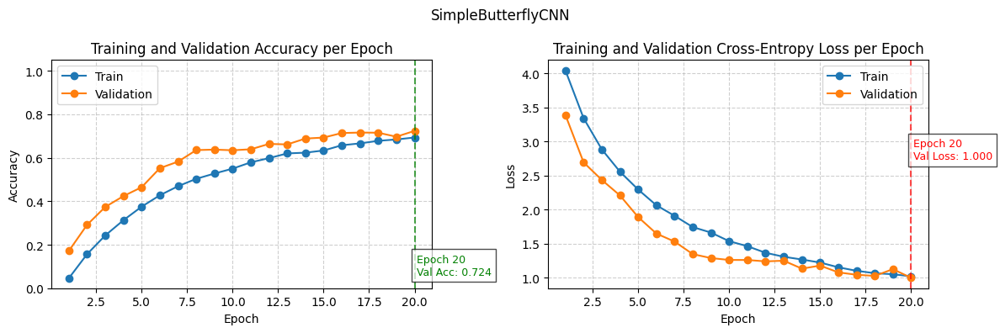

In [169]:
# SimpleButterflyCNN
# visualize training and validation accuracy and loss over epochs -- find if overfitting or underfitting and convergence
epochs_range = range(1, len(train_losses) + 1)

plt.figure(figsize=(12, 4))

# accuracy plot
plt.subplot(1, 2, 1)
best_acc_epoch = np.argmax(val_accs)
plt.plot(epochs_range, train_accs, marker='o', label='Train')
plt.plot(epochs_range, val_accs, marker='o', label='Validation')
plt.axvline(best_acc_epoch+1, color='green', linestyle='--', alpha=0.7)
plt.text(best_acc_epoch+1.1, 0.05, 
         f'Epoch {best_acc_epoch+1}\nVal Acc: {val_accs[best_acc_epoch]:.3f}',
         color='green', fontsize=9, verticalalignment='bottom', bbox=dict(facecolor='white', alpha=0.7))
plt.title('Training and Validation Accuracy per Epoch')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.ylim([0, 1.05])
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend(['Train', 'Validation'], loc='upper left')

# loss plot
plt.subplot(1, 2, 2)
best_loss_epoch = np.argmin(val_losses)
plt.plot(epochs_range, train_losses, marker='o', label='Train')
plt.plot(epochs_range, val_losses, marker='o', label='Validation')
plt.axvline(best_loss_epoch+1, color='red', linestyle='--', alpha=0.7)
plt.text(best_loss_epoch+1.1, max(val_losses)*0.9, 
         f'Epoch {best_loss_epoch+1}\nVal Loss: {val_losses[best_loss_epoch]:.3f}',
         color='red', fontsize=9, verticalalignment='top', bbox=dict(facecolor='white', alpha=0.7))
plt.title('Training and Validation Cross-Entropy Loss per Epoch')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend(['Train', 'Validation'], loc='upper right')

plt.suptitle('SimpleButterflyCNN')
plt.tight_layout()
plt.show()

In [157]:
# with SimpleButterflyCNN model, accuracy plateaus around ~72% after 20 epochs -- limitations from model capacity and lacking pretraining

# SimpleButterflyCNN not be able to capture all subtle differences between 75 butterfly classes -- ResNet50 may reach ~90% in classification
# so I will use transfer learning from a pre-trained model (ResNet50)

In [ ]:
# ResNet50 as alternative to SimpleButterflyCNN

In [173]:
# ResNet50 -- training loop & setup
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

num_classes = len(train_dataset.classes)
initial_lr = 0.001
step_size = 7
gamma = 0.1

# init ResNet50
model = models.resnet50(weights="IMAGENET1K_V1")
model.fc = nn.Linear(model.fc.in_features, num_classes)  # replace the final fully connected layer
model = model.to(device)

optimizer = optim.Adam(model.parameters(), lr=initial_lr)
scheduler = StepLR(optimizer, step_size=step_size, gamma=gamma)  # drop lr after 7 epochs to imrpove accuracy
criterion = nn.CrossEntropyLoss()
epochs = 20 # 32 max

# init trackers list for each epoch
train_losses = []
train_accs = []
val_losses = []
val_accs = []
all_labels = []
all_preds = []

# training loop
for epoch in range(epochs):    
    model.train()
    running_loss = 0.0
    correct = 0
    total = 0

    # for each batch in traiing set
    for images, labels in tqdm(train_loader, desc=f"Epoch {epoch+1}/{epochs} [Train]"):
        images, labels = images.to(device), labels.to(device)
        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        # accuracy / correct predictions
        running_loss += loss.item() * images.size(0)
        _, preds = torch.max(outputs, 1)
        correct += (preds == labels).sum().item()
        total += labels.size(0)

    # train, validation metrics
    train_loss = running_loss / total
    train_acc = correct / total
    train_losses.append(train_loss)
    train_accs.append(train_acc)

    # for validation evaluation
    model.eval()
    val_loss = 0.0
    val_correct = 0
    val_total = 0
    epoch_labels = []
    epoch_preds = []
    
    with torch.no_grad():
        for images, labels in tqdm(val_loader, desc=f"Epoch {epoch+1}/{epochs} [Val]"):
            images, labels = images.to(device), labels.to(device)
            # validation loss
            outputs = model(images)
            loss = criterion(outputs, labels)
            # validation accuracy / predictions
            val_loss += loss.item() * images.size(0)
            _, preds = torch.max(outputs, 1)
            val_correct += (preds == labels).sum().item()
            val_total += labels.size(0)
            epoch_labels.extend(labels.cpu().numpy())
            epoch_preds.extend(preds.cpu().numpy())

    val_loss /= val_total
    val_acc = val_correct / val_total
    val_losses.append(val_loss)
    val_accs.append(val_acc)
    all_labels.append(epoch_labels)
    all_preds.append(epoch_preds)

    scheduler.step()
    
    print(f"Epoch {epoch+1}/{epochs} | "
          f"Train Loss: {train_loss:.4f} | Train Acc: {train_acc:.4f} | Val Acc: {val_acc:.4f} | Val Loss: {val_loss:.4f}")

Epoch 1/20 [Val]: 100%|████████████████████████████████████████████████████████████████| 41/41 [00:28<00:00,  1.43it/s]


Epoch 1/20 | Train Loss: 2.8401 | Train Acc: 0.2824 | Val Acc: 0.3631 | Val Loss: 2.4864


Epoch 2/20 [Val]: 100%|████████████████████████████████████████████████████████████████| 41/41 [00:28<00:00,  1.45it/s]


Epoch 2/20 | Train Loss: 1.5261 | Train Acc: 0.5495 | Val Acc: 0.6192 | Val Loss: 1.2597


Epoch 3/20 [Val]: 100%|████████████████████████████████████████████████████████████████| 41/41 [00:27<00:00,  1.48it/s]


Epoch 3/20 | Train Loss: 1.1053 | Train Acc: 0.6701 | Val Acc: 0.6338 | Val Loss: 1.2618


Epoch 4/20 [Val]: 100%|████████████████████████████████████████████████████████████████| 41/41 [00:26<00:00,  1.55it/s]


Epoch 4/20 | Train Loss: 0.8791 | Train Acc: 0.7359 | Val Acc: 0.7415 | Val Loss: 0.9597


Epoch 5/20 [Val]: 100%|████████████████████████████████████████████████████████████████| 41/41 [00:26<00:00,  1.53it/s]


Epoch 5/20 | Train Loss: 0.7108 | Train Acc: 0.7798 | Val Acc: 0.7469 | Val Loss: 0.8768


Epoch 6/20 [Val]: 100%|████████████████████████████████████████████████████████████████| 41/41 [00:26<00:00,  1.53it/s]


Epoch 6/20 | Train Loss: 0.6595 | Train Acc: 0.7963 | Val Acc: 0.7438 | Val Loss: 0.8841


Epoch 7/20 [Val]: 100%|████████████████████████████████████████████████████████████████| 41/41 [00:26<00:00,  1.53it/s]


Epoch 7/20 | Train Loss: 0.5779 | Train Acc: 0.8200 | Val Acc: 0.7685 | Val Loss: 0.8332


Epoch 8/20 [Val]: 100%|████████████████████████████████████████████████████████████████| 41/41 [00:28<00:00,  1.44it/s]


Epoch 8/20 | Train Loss: 0.3249 | Train Acc: 0.8994 | Val Acc: 0.8938 | Val Loss: 0.4341


Epoch 9/20 [Val]: 100%|████████████████████████████████████████████████████████████████| 41/41 [00:26<00:00,  1.53it/s]


Epoch 9/20 | Train Loss: 0.2231 | Train Acc: 0.9342 | Val Acc: 0.9000 | Val Loss: 0.4170


Epoch 10/20 [Val]: 100%|███████████████████████████████████████████████████████████████| 41/41 [00:26<00:00,  1.53it/s]


Epoch 10/20 | Train Loss: 0.2026 | Train Acc: 0.9354 | Val Acc: 0.9108 | Val Loss: 0.4074


Epoch 11/20 [Val]: 100%|███████████████████████████████████████████████████████████████| 41/41 [00:26<00:00,  1.54it/s]


Epoch 11/20 | Train Loss: 0.1753 | Train Acc: 0.9436 | Val Acc: 0.9015 | Val Loss: 0.4251


Epoch 12/20 [Val]: 100%|███████████████████████████████████████████████████████████████| 41/41 [00:26<00:00,  1.53it/s]


Epoch 12/20 | Train Loss: 0.1585 | Train Acc: 0.9446 | Val Acc: 0.9100 | Val Loss: 0.4141


Epoch 13/20 [Val]: 100%|███████████████████████████████████████████████████████████████| 41/41 [00:26<00:00,  1.52it/s]


Epoch 13/20 | Train Loss: 0.1440 | Train Acc: 0.9542 | Val Acc: 0.9146 | Val Loss: 0.4130


Epoch 14/20 [Val]: 100%|███████████████████████████████████████████████████████████████| 41/41 [00:26<00:00,  1.54it/s]


Epoch 14/20 | Train Loss: 0.1263 | Train Acc: 0.9579 | Val Acc: 0.9100 | Val Loss: 0.4297


Epoch 15/20 [Val]: 100%|███████████████████████████████████████████████████████████████| 41/41 [00:26<00:00,  1.53it/s]


Epoch 15/20 | Train Loss: 0.1055 | Train Acc: 0.9654 | Val Acc: 0.9138 | Val Loss: 0.4193


Epoch 16/20 [Val]: 100%|███████████████████████████████████████████████████████████████| 41/41 [00:26<00:00,  1.53it/s]


Epoch 16/20 | Train Loss: 0.1055 | Train Acc: 0.9650 | Val Acc: 0.9162 | Val Loss: 0.4158


Epoch 17/20 [Val]: 100%|███████████████████████████████████████████████████████████████| 41/41 [00:26<00:00,  1.53it/s]


Epoch 17/20 | Train Loss: 0.0994 | Train Acc: 0.9688 | Val Acc: 0.9154 | Val Loss: 0.4186


Epoch 18/20 [Val]: 100%|███████████████████████████████████████████████████████████████| 41/41 [00:26<00:00,  1.55it/s]


Epoch 18/20 | Train Loss: 0.0941 | Train Acc: 0.9704 | Val Acc: 0.9177 | Val Loss: 0.4125


Epoch 19/20 [Val]: 100%|███████████████████████████████████████████████████████████████| 41/41 [00:28<00:00,  1.44it/s]


Epoch 19/20 | Train Loss: 0.0946 | Train Acc: 0.9700 | Val Acc: 0.9146 | Val Loss: 0.4172


Epoch 20/20 [Val]: 100%|███████████████████████████████████████████████████████████████| 41/41 [00:26<00:00,  1.54it/s]

Epoch 20/20 | Train Loss: 0.0926 | Train Acc: 0.9669 | Val Acc: 0.9115 | Val Loss: 0.4293


In [174]:
# print summary of training process and hyperparameters -- ResNet50

print("\n=== Training Summary ===")
print(f"Model: ResNet50 (pretrained on ImageNet, final layer for 75 classes)")
print(f"Epochs completed: {epochs}")
print(f"Optimizer: {optimizer.__class__.__name__}")
print(f"Batch size: {train_loader.batch_size}")
print(f"Initial Learning Rate: {initial_lr}")
print(f"Learning Rate Scheduler: StepLR (step_size={step_size}, gamma={gamma})")
print(f"Final Learning Rate after {epochs} epochs: {optimizer.param_groups[0]['lr']}")
print(f"Loss function: {criterion.__class__.__name__}")
print(f"Data augmentation: RandomResizedCrop, Flip, Rotation, ColorJitter")

print("\n--- Final Metrics ---")
print(f"Final Training Loss: {train_losses[-1]:.4f}")
print(f"Final Validation Loss: {val_losses[-1]:.4f}")
print(f"Final Training Accuracy: {train_accs[-1]*100:.2f}%")
print(f"Final Validation Accuracy: {val_accs[-1]*100:.2f}%")

best_val_acc = max(val_accs)
best_epoch = val_accs.index(best_val_acc) + 1
print(f"Best Validation Accuracy: {best_val_acc*100:.2f}% at epoch {best_epoch}")

best_val_loss = min(val_losses)
best_loss_epoch = val_losses.index(best_val_loss) + 1
print(f"Best Validation Loss: {best_val_loss:.4f} at epoch {best_loss_epoch}")


=== Training Summary ===
Model: ResNet50 (pretrained on ImageNet, final layer for 75 classes)
Epochs completed: 20
Optimizer: Adam
Batch size: 32
Initial Learning Rate: 0.001
Learning Rate Scheduler: StepLR (step_size=7, gamma=0.1)
Final Learning Rate after 20 epochs: 1e-05
Loss function: CrossEntropyLoss
Data augmentation: RandomResizedCrop, Flip, Rotation, ColorJitter

--- Final Metrics ---
Final Training Loss: 0.0926
Final Validation Loss: 0.4293
Final Training Accuracy: 96.69%
Final Validation Accuracy: 91.15%
Best Validation Accuracy: 91.77% at epoch 18
Best Validation Loss: 0.4074 at epoch 10


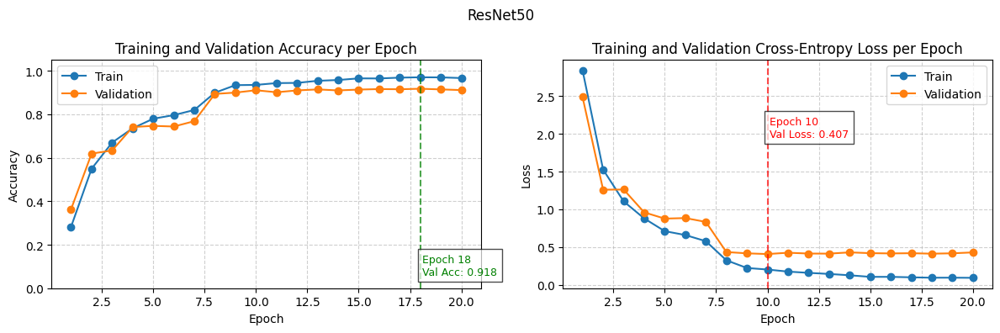

In [175]:
# visualize training and validation accuracy and loss over epochs -- find if overfitting or underfitting and convergence
epochs_range = range(1, len(train_losses) + 1)

plt.figure(figsize=(12, 4))

# accuracy plot
plt.subplot(1, 2, 1)
best_acc_epoch = np.argmax(val_accs)
plt.plot(epochs_range, train_accs, marker='o', label='Train')
plt.plot(epochs_range, val_accs, marker='o', label='Validation')
plt.axvline(best_acc_epoch+1, color='green', linestyle='--', alpha=0.7)
plt.text(best_acc_epoch+1.1, 0.05, 
         f'Epoch {best_acc_epoch+1}\nVal Acc: {val_accs[best_acc_epoch]:.3f}',
         color='green', fontsize=9, verticalalignment='bottom', bbox=dict(facecolor='white', alpha=0.7))
plt.title('Training and Validation Accuracy per Epoch')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.ylim([0, 1.05])
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend(['Train', 'Validation'], loc='upper left')

# loss plot
plt.subplot(1, 2, 2)
best_loss_epoch = np.argmin(val_losses)
plt.plot(epochs_range, train_losses, marker='o', label='Train')
plt.plot(epochs_range, val_losses, marker='o', label='Validation')
plt.axvline(best_loss_epoch+1, color='red', linestyle='--', alpha=0.7)
plt.text(best_loss_epoch+1.1, max(val_losses)*0.9, 
         f'Epoch {best_loss_epoch+1}\nVal Loss: {val_losses[best_loss_epoch]:.3f}',
         color='red', fontsize=9, verticalalignment='top', bbox=dict(facecolor='white', alpha=0.7))
plt.title('Training and Validation Cross-Entropy Loss per Epoch')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend(['Train', 'Validation'], loc='upper right')

plt.suptitle('ResNet50')
plt.tight_layout()
plt.show()

In [147]:
# validation

In [181]:
# classification report & metrics for precision, recall, F1-score

model.eval()
all_labels = []
all_preds = []

with torch.no_grad():
    for images, labels in tqdm(val_loader):
        images, labels = images.to(device), labels.to(device)
        outputs = model(images)
        _, preds = torch.max(outputs, 1)
        all_labels.extend(labels.cpu().numpy())
        all_preds.extend(preds.cpu().numpy())

print("Classification Report:")
print(classification_report(all_labels, all_preds, target_names=train_dataset.classes))

100%|██████████████████████████████████████████████████████████████████████████████████| 41/41 [00:26<00:00,  1.53it/s]

Classification Report:
                           precision    recall  f1-score   support

                   ADONIS       0.90      1.00      0.95        18
AFRICAN GIANT SWALLOWTAIL       1.00      0.87      0.93        15
           AMERICAN SNOOT       0.93      0.93      0.93        15
                    AN 88       1.00      1.00      1.00        17
                  APPOLLO       0.94      0.89      0.91        18
                    ATALA       1.00      1.00      1.00        20
 BANDED ORANGE HELICONIAN       1.00      0.95      0.97        20
           BANDED PEACOCK       0.89      1.00      0.94        17
            BECKERS WHITE       0.73      1.00      0.84        16
         BLACK HAIRSTREAK       0.93      0.82      0.88        17
              BLUE MORPHO       0.93      0.87      0.90        15
        BLUE SPOTTED CROW       0.94      1.00      0.97        17
           BROWN SIPROETA       0.90      0.90      0.90        20
            CABBAGE WHITE       0.90  

In [177]:
# visualize metrics for model performance for all classes/labels: per-class precision, recall, F1-score, and support
precision, recall, f1, support = precision_recall_fscore_support(
    all_labels, all_preds, labels=range(len(train_dataset.classes))
)
class_labels = train_dataset.classes

# metrivs dataframe
metrics_df = pd.DataFrame({
    'Precision': precision,
    'Recall': recall,
    'F1-Score': f1,
    'Support': support
}, index=class_labels)

display(metrics_df.style.background_gradient(cmap='YlGnBu', subset=['Precision', 'Recall', 'F1-Score']))

,Precision,Recall,F1-Score,Support
ADONIS,0.900000,1.000000,0.947368,18
AFRICAN GIANT SWALLOWTAIL,1.000000,0.866667,0.928571,15
AMERICAN SNOOT,0.933333,0.933333,0.933333,15
AN 88,1.000000,1.000000,1.000000,17
APPOLLO,0.941176,0.888889,0.914286,18
ATALA,1.000000,1.000000,1.000000,20
BANDED ORANGE HELICONIAN,1.000000,0.950000,0.974359,20
BANDED PEACOCK,0.894737,1.000000,0.944444,17
BECKERS WHITE,0.727273,1.000000,0.842105,16
BLACK HAIRSTREAK,0.933333,0.823529,0.875000,17


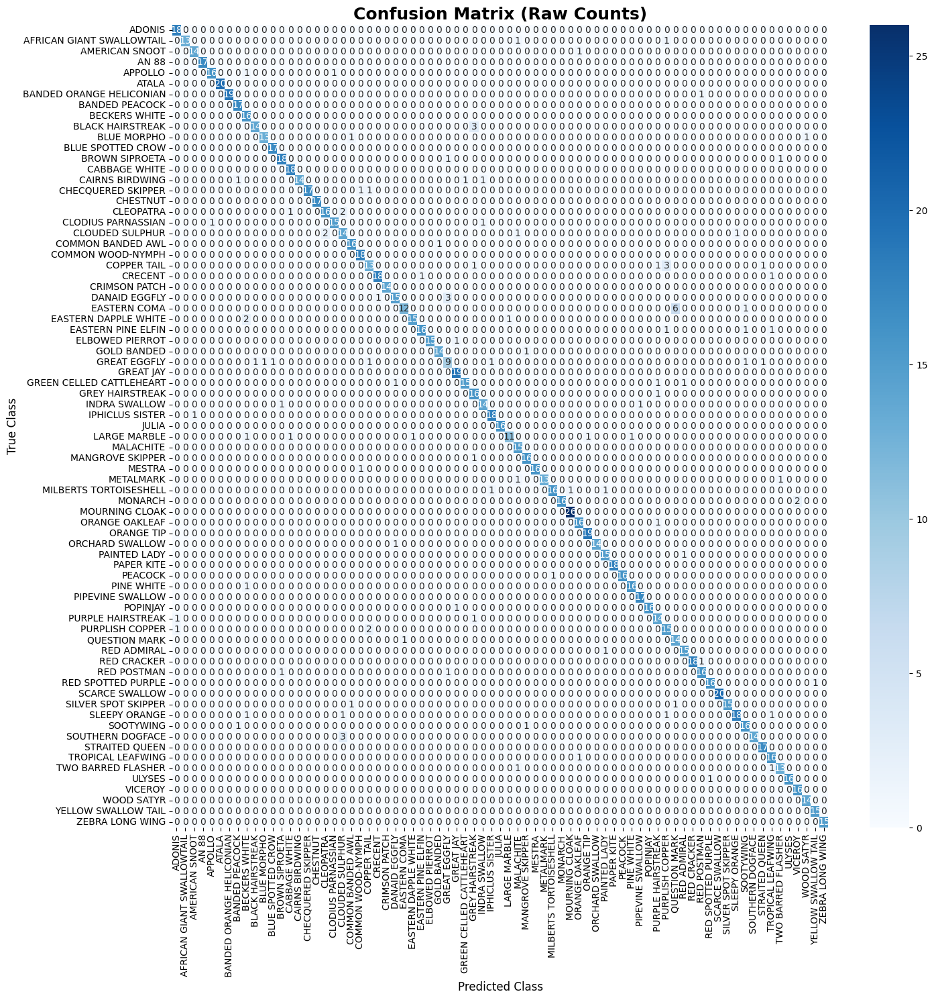

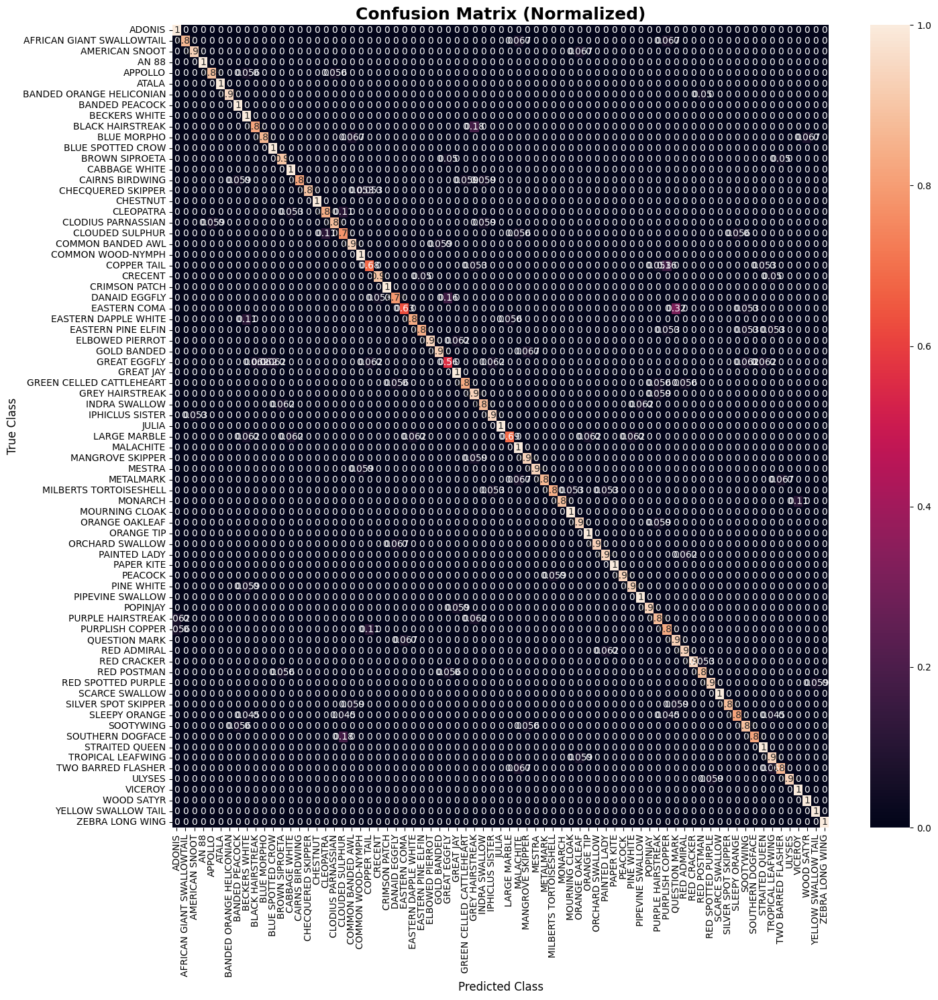

In [182]:
# visualize confusion matrix -- identify which classes/labels are often confused
cm = confusion_matrix(all_labels, all_preds)

plt.figure(figsize=(15,15))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=class_labels,
            yticklabels=class_labels)
plt.xlabel('Predicted Class', fontsize=12)
plt.ylabel('True Class', fontsize=12)
plt.title('Confusion Matrix (Raw Counts)', fontsize=18, fontweight='bold')
plt.tight_layout()
plt.show()

# visualize normalized confusion matrix -- identify which classes/labels are often confused
cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

plt.figure(figsize=(15,15))
sns.heatmap(
    cm_normalized,
    annot=True,
    # cmap='YlGnBu',
    xticklabels=class_labels,
    yticklabels=class_labels,
)
plt.xlabel('Predicted Class', fontsize=12)
plt.ylabel('True Class', fontsize=12)
plt.title('Confusion Matrix (Normalized)', fontsize=18, fontweight='bold')
plt.tight_layout()
plt.show()

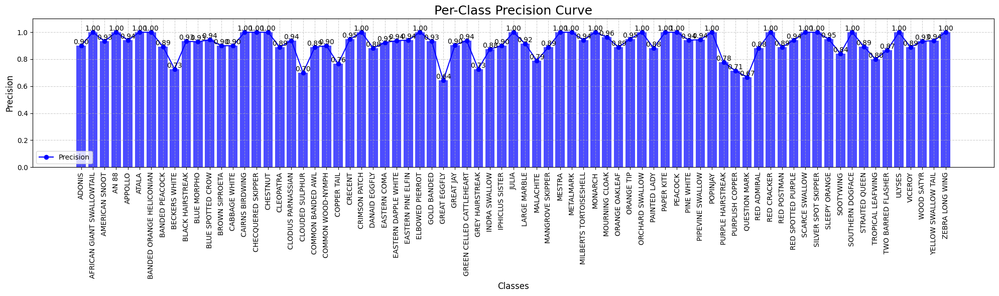

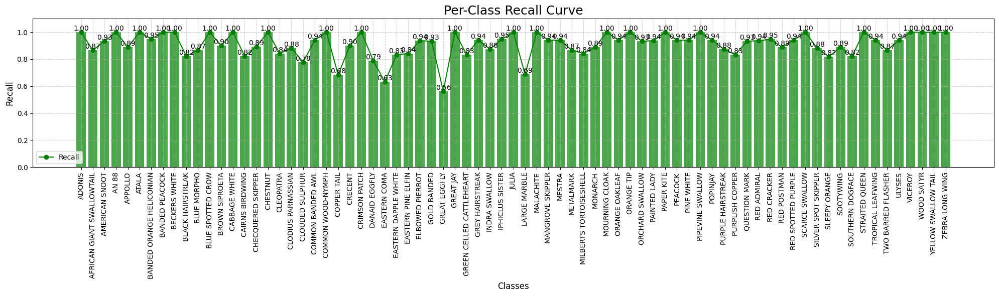

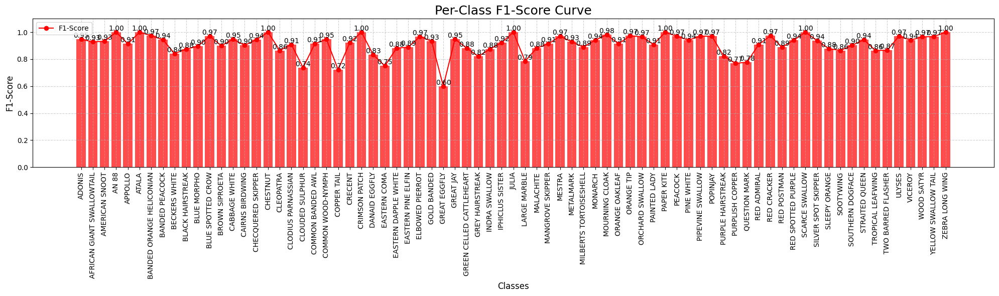

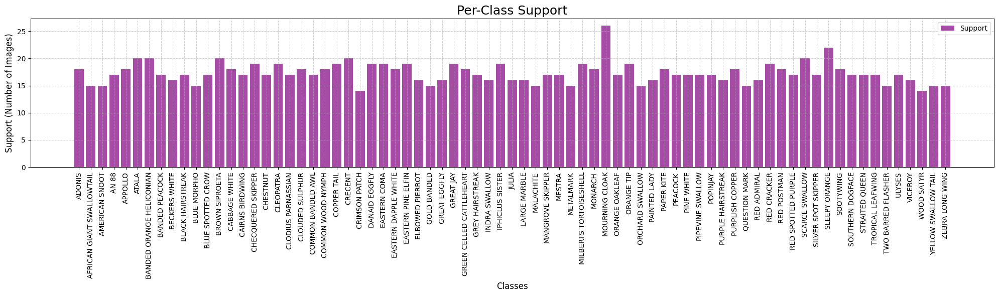

In [185]:
# visualize per -class metric distributions (precision, recall, F1-score)
def plot_metric(metric_values, metric_name, color):
    x = range(len(class_labels))
    plt.figure(figsize=(20, 6))
    bars = plt.bar(class_labels, metric_values, color=color, alpha=0.7)
    plt.ylim([0, 1.10])
    
    for bar in bars:
        height = bar.get_height()
        plt.text(bar.get_x() + bar.get_width()/2., height,
                f'{height:.2f}', ha='center', va='bottom')
    
    plt.plot(x, metric_values, marker="o", linestyle="-", color=color, label=metric_name)
    plt.xticks(x, class_labels, rotation=90)
    plt.xlabel("Classes", fontsize=12)
    plt.ylabel(metric_name, fontsize=12)
    plt.title(f"Per-Class {metric_name} Distribution", fontsize=18)
    plt.legend()
    plt.grid(True, linestyle="--", alpha=0.6)
    plt.tight_layout()
    plt.show()
    
# visualize per-class support distributions
# distribution of image counts (num images) across classes in validation set to identify if any class imbalance issues
def plot_support(support, class_labels, color="purple"):
    x = range(len(class_labels))
    plt.figure(figsize=(20, 6))
    plt.bar(x, support, color=color, alpha=0.7, label="Support")
    plt.xticks(x, class_labels, rotation=90)
    plt.xlabel("Classes", fontsize=12)
    plt.ylabel("Support (Number of Images)", fontsize=12)
    plt.title("Per-Class Support", fontsize=18)
    plt.legend()
    plt.grid(True, linestyle="--", alpha=0.6)
    plt.tight_layout()
    plt.show()

# plot all metrics
plot_metric(precision, "Precision", "blue")
plot_metric(recall, "Recall", "green")
plot_metric(f1, "F1-Score", "red")
plot_support(support, class_labels)

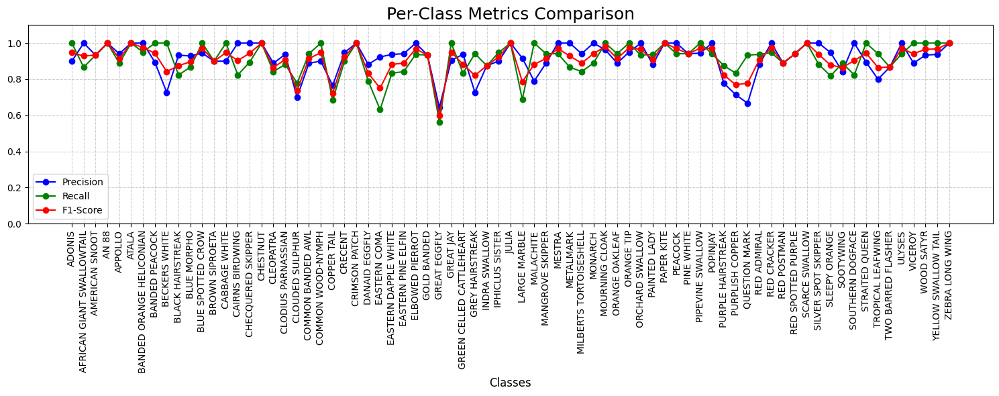

In [188]:
# visualize combined metrics: Precision, Recall, F1-Score (line plots)
# identifies the accuracy of the model when predicting each label/class (high scores = high acc., low scores = lower acc.)
plt.figure(figsize=(15,6))
x = range(len(class_labels))
plt.plot(x, precision, 'o-', color='blue', label='Precision')
plt.plot(x, recall, 'o-', color='green', label='Recall')
plt.plot(x, f1, 'o-', color='red', label='F1-Score')
plt.xticks(x, class_labels, rotation=90)
plt.ylim([0, 1.10])
plt.legend()
plt.grid(True, linestyle='--', alpha=0.6)
plt.title('Per-Class Metrics Comparison', fontsize=18)
plt.xlabel("Classes", fontsize=12)
plt.tight_layout()
plt.show()

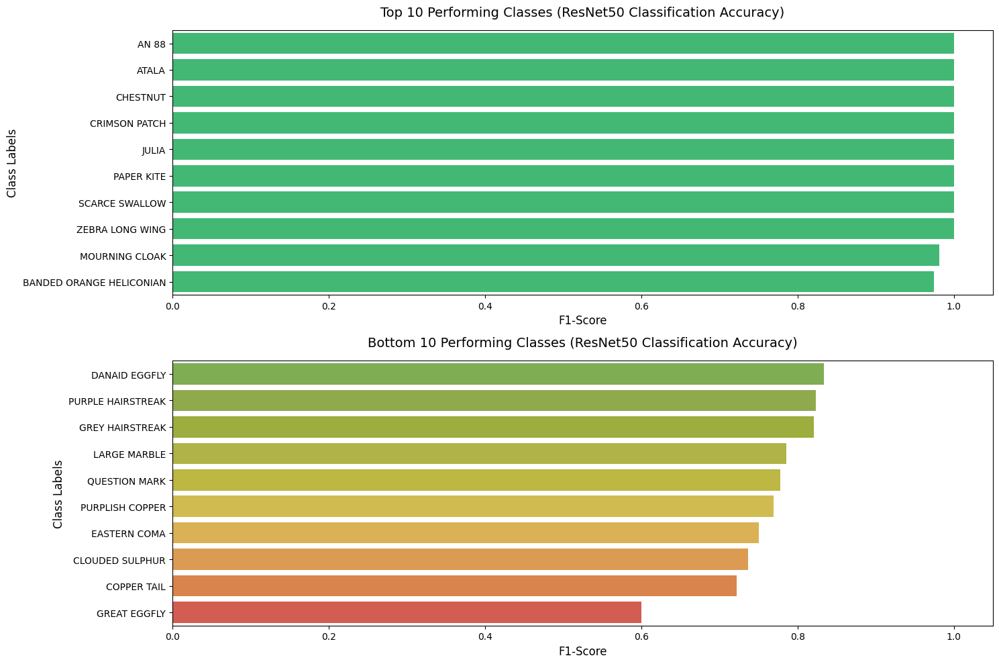

In [189]:
# visualize top 10 and bottom 10 classes
top_classes = metrics_df.nlargest(10, 'F1-Score')
bot_classes = metrics_df.nsmallest(10, 'F1-Score').sort_values('F1-Score', ascending=False)

top_palette = ["#2ecc71"] * 10  # uniform green (best, 100%)
bot_palette = [
    "#7fbc45",  # 86% green
    "#95ba3d",  # 84%
    "#aabf2c",  # 82%
    "#c0c536",  # 80%
    "#d1c92f",  # 78% yellow-green
    "#e6c93a",  # 76% yellow
    "#f0b93e",  # 74% yellow-orange
    "#f29c3b",  # 72% orange
    "#f07f35",  # 71.5% red-orange
    "#e74c3c"   # 71% red (worst)
]

fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(15,10))

# top performing analysis/classification
sns.barplot(x='F1-Score', y=top_classes.index, hue=top_classes.index, data=top_classes, ax=ax1, palette=top_palette)
ax1.set_title('Top 10 Performing Classes (ResNet50 Classification Accuracy)', fontsize=14, pad=15)
ax1.set_xlim(0, 1.05)
ax1.set_ylabel('Class Labels', fontsize=12) 
ax1.set_xlabel('F1-Score', fontsize=12) 

# bottom performing analysis/classification
sns.barplot(x='F1-Score', y=bot_classes.index, hue=bot_classes.index, data=bot_classes, ax=ax2, palette=bot_palette)
ax2.set_title('Bottom 10 Performing Classes (ResNet50 Classification Accuracy)', fontsize=14, pad=15)
ax2.set_xlim(0, 1.05)
ax2.set_ylabel('Class Labels', fontsize=12)
ax2.set_xlabel('F1-Score', fontsize=12) 

plt.tight_layout()
plt.show()

Perfect batch accuracy: 1.0
Worst batch accuracies: ['78.1%', '65.6%', '78.1%']


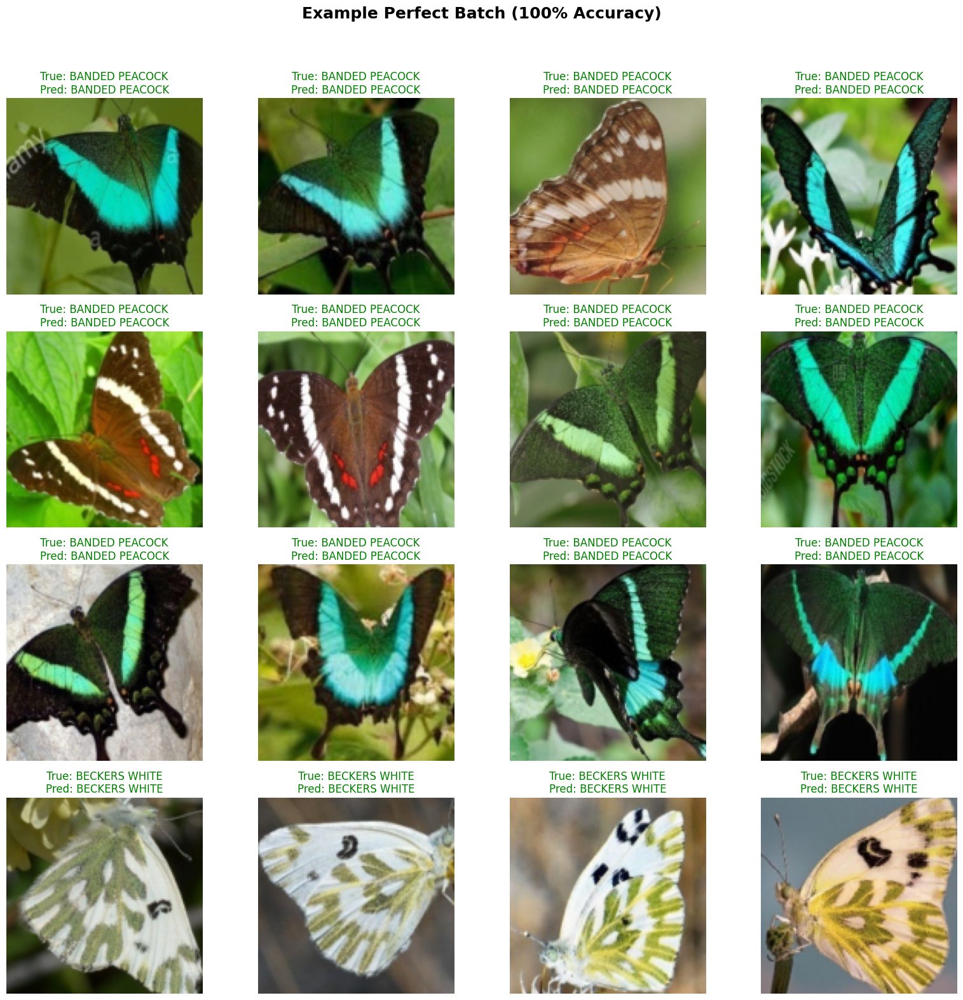

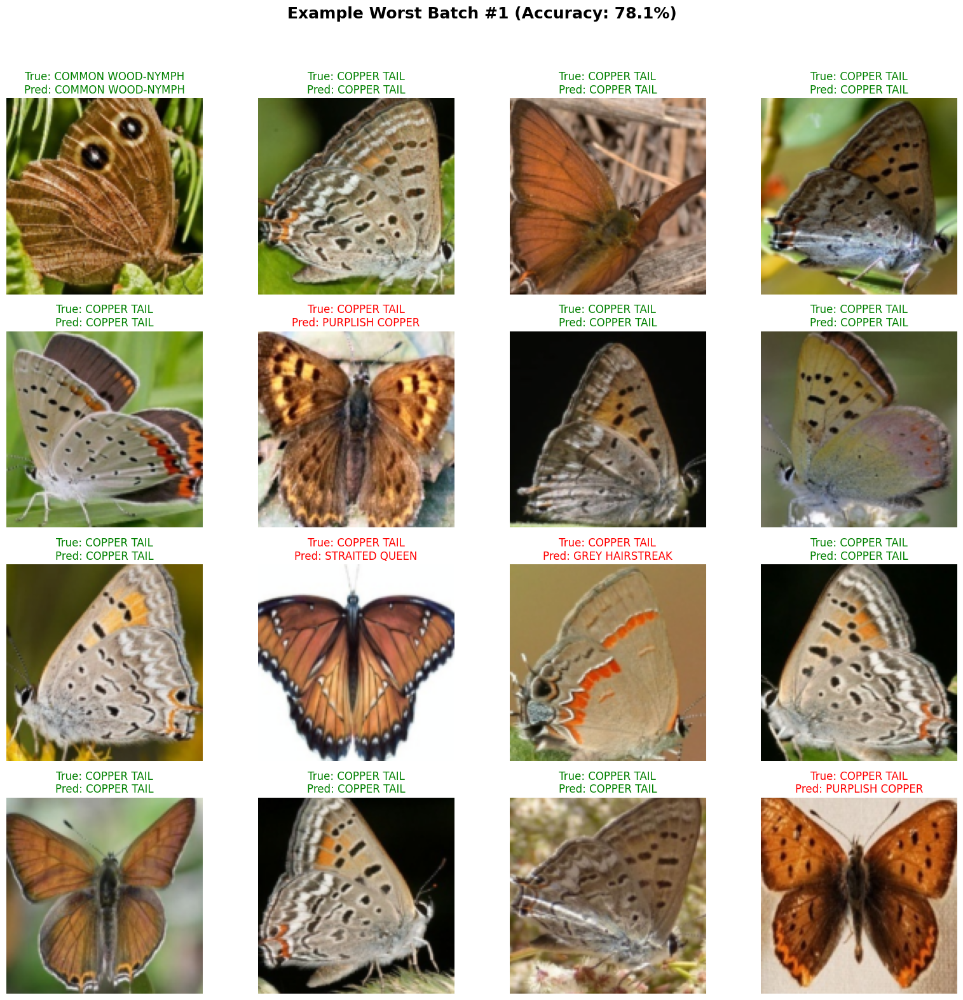

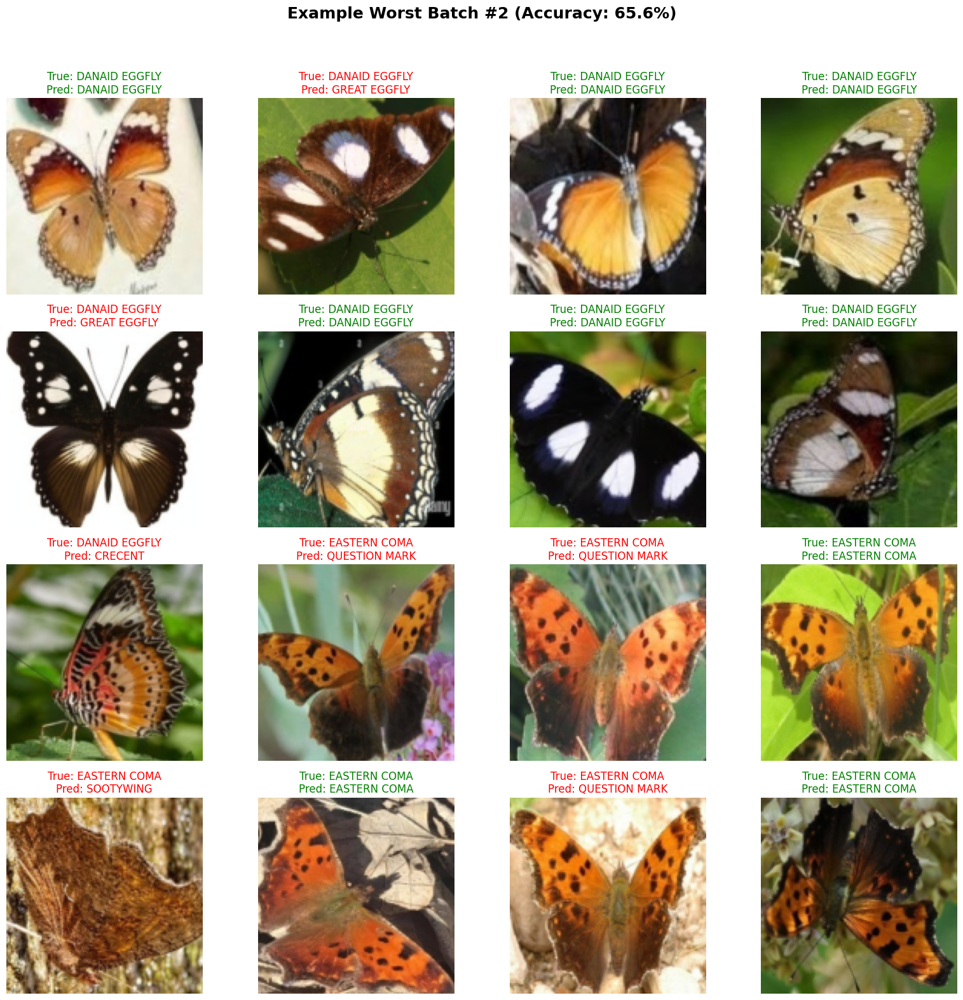

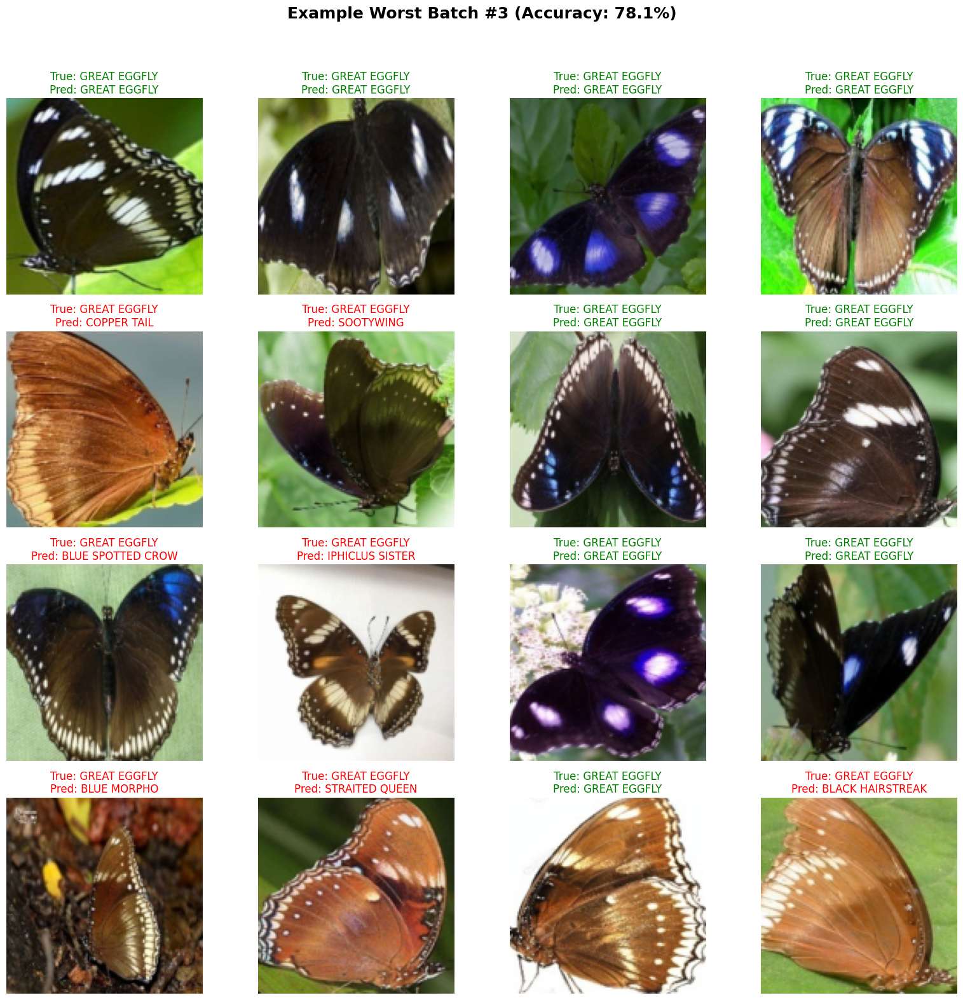

In [190]:
# init trackers
perfect_batch = None
worst_batches = []
worst_scores = []

# identify batch accuracy for perfect (100%) and worst (<=100%) accuracy
val_iter = iter(val_loader)
for batch_idx, (images, labels) in enumerate(val_iter):
    images = images.to(device)
    outputs = model(images)
    _, preds = torch.max(outputs, 1)
    
    correct = (preds == labels.to(device)).sum().item()
    accuracy = correct / len(labels)
    
    if accuracy == 1.0 and perfect_batch is None:
        perfect_batch = (images, labels, preds)
    
    if len(worst_batches) < 3 or accuracy < max(worst_scores):
        worst_batches.append((images, labels, preds, accuracy))
        worst_scores.append(accuracy)
        if len(worst_batches) > 3:
            # Remove least-worst batch
            idx = worst_scores.index(max(worst_scores))
            worst_batches.pop(idx)
            worst_scores.pop(idx)

print(f"Perfect batch accuracy: {1.0 if perfect_batch else 'N/A'}")
print("Worst batch accuracies:", [f"{acc:.1%}" for acc in worst_scores])

# visualize batches
def visualize_batch(batch, title):
    images, labels, preds = batch
    num_images = min(16, images.size(0))
    rows = int(np.ceil(num_images / 4))
    plt.figure(figsize=(16, 4 * rows))
    
    for i in range(num_images):
        plt.subplot(rows, 4, i + 1)
        img = images[i].cpu().permute(1, 2, 0).numpy()
        img = img * [0.229, 0.224, 0.225] + [0.485, 0.456, 0.406]
        img = np.clip(img, 0, 1)
        plt.imshow(img)
        
        true_label = train_dataset.classes[labels[i]]
        pred_label = train_dataset.classes[preds[i]]
        color = 'green' if true_label == pred_label else 'red'
        plt.title(f"True: {true_label}\nPred: {pred_label}", color=color, fontsize=12)
        plt.axis('off')
    
    plt.suptitle(title, fontsize=18, fontweight='bold')
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

# example perfect batch
if perfect_batch:
    visualize_batch(perfect_batch, "Example Perfect Batch (100% Accuracy)")
else:
    print("No perfect batch found!")

# example worst batches
for i, batch_data in enumerate(worst_batches):
    images, labels, preds, acc = batch_data  # Unpack all 4 elements
    visualize_batch((images, labels, preds), f"Example Worst Batch #{i+1} (Accuracy: {acc:.1%})")

In [191]:
# infer on unlabeled test set -- predict classification/label for unlabeled test set images

# for unlabeled test set
class TestDataset(Dataset):
    def __init__(self, csv_file, root_dir, transform=None):
        self.data = pd.read_csv(csv_file)
        self.root_dir = root_dir
        self.transform = transform

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        filename = self.data.iloc[idx, 0]
        img_path = os.path.join(self.root_dir, filename)
        image = Image.open(img_path).convert('RGB')
        if self.transform:
            image = self.transform(image)
        return image, filename

# create test dataset and data loader (no shuffling, preserves order)
test_dataset = TestDataset(test_csv, test_dir, transform=transform_val)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

# set model to evaluate
model.eval()
test_predictions = []
test_filenames = []
with torch.no_grad():
    for images, filenames in test_loader:
        # for each, get model outputs for the batch and store predicted class/label indices
        images = images.to(device)
        outputs = model(images)
        _, preds = torch.max(outputs, 1)
        test_predictions.extend(preds.cpu().numpy())
        test_filenames.extend(filenames)

# map predicted indices to class names using training set mapping for predictions
idx_to_class = {v: k for k, v in train_dataset.class_to_idx.items()}
predicted_classes = [idx_to_class[idx] for idx in test_predictions]

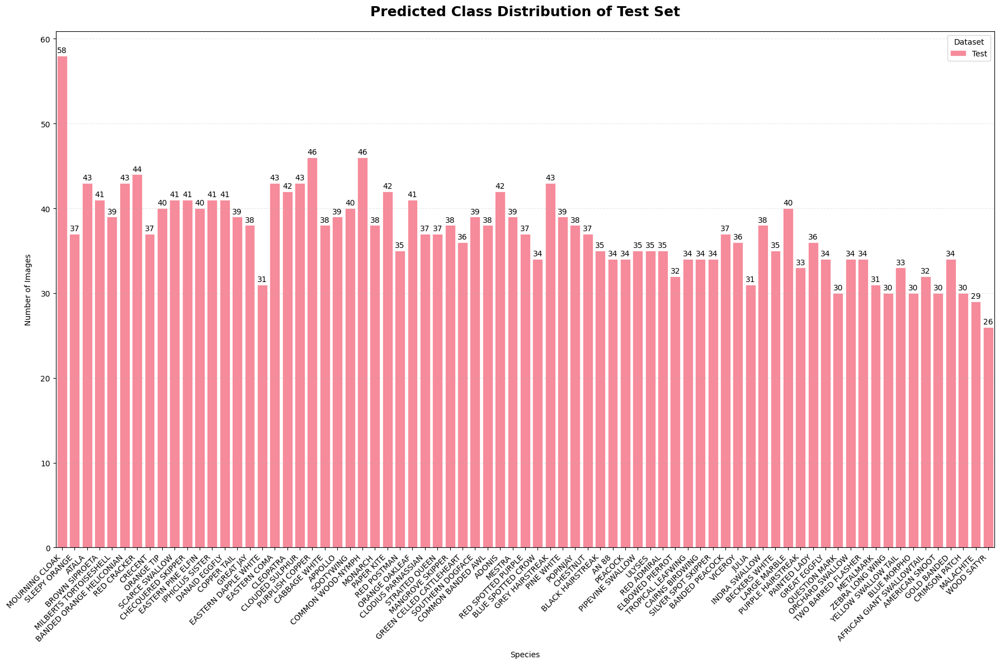

In [199]:
# visualize the predicted class distribution of testing set -- can see if biases exist in classifying for certain classes/labels
test_df = pd.DataFrame({'label': predicted_classes, 'split': 'Test'})

plt.figure(figsize=(18, 12))
ax = sns.countplot(
    x='label',
    hue='split',
    data=test_df,
    order=class_order,  # same order as train/val
    palette=['#ff8294'],  # test = salmon-ish pink
    saturation=0.85,
    linewidth=0.5,
    edgecolor="white"
)

# value labels
for container in ax.containers:
    ax.bar_label(
        container,
        labels=[f'{int(x):,}' if x > 0 else '' for x in container.datavalues],
        label_type='edge',
        padding=2,
        fontsize=10
    )

plt.xticks(rotation=45, ha='right')
plt.title('Predicted Class Distribution of Test Set', pad=20, fontsize=18, fontweight='bold')
plt.ylabel('Number of Images', labelpad=10)
plt.xlabel('Species', labelpad=10)
ax.yaxis.grid(True, linestyle='--', alpha=0.3)
plt.legend(title='Dataset')
plt.tight_layout()
plt.show()

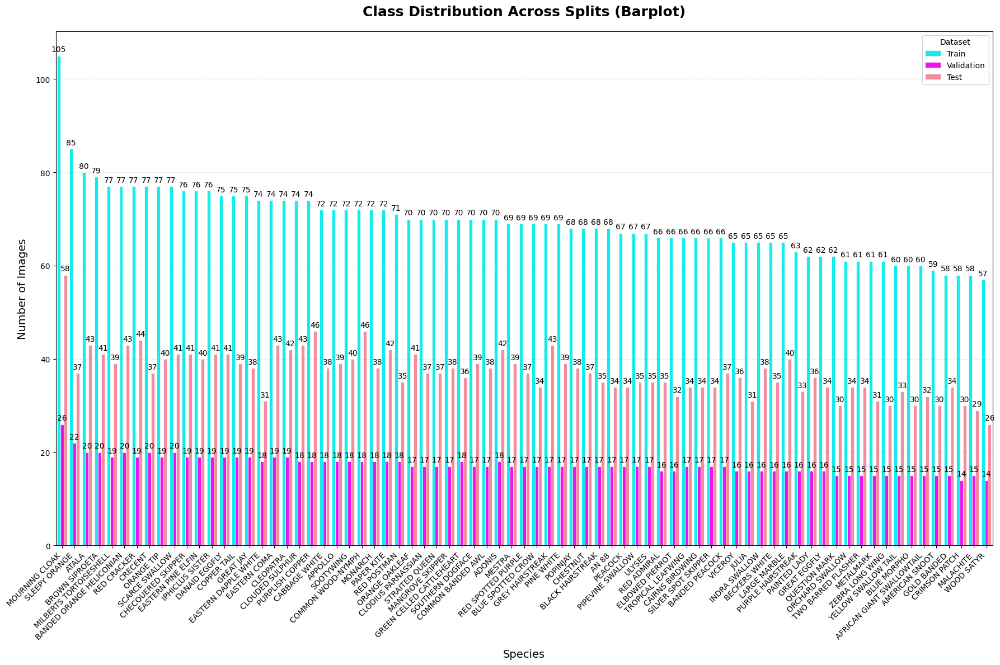

In [193]:
# visualize -- combined class distributions of images in train-validation-test sets
combined_df = pd.concat([train_df, val_df, test_df], ignore_index=True)
PALETTE = ['cyan', 'magenta', '#ff8294']

plt.figure(figsize=(18, 12))
ax = sns.countplot(
    x='label',
    hue='split',
    data=combined_df,
    order=class_order,
    palette=PALETTE,
    saturation=0.85,
    edgecolor="white",
    linewidth=0.5
)

# value labels
for container in ax.containers:
    labels = [f'{int(x):,}' if x > 0 else '' for x in container.datavalues]
    ax.bar_label(
        container,
        labels=labels,
        label_type='edge',
        padding=3,
        fontsize=10,
    )

plt.xticks(rotation=45, ha='right', fontsize=10)
plt.title('Class Distribution Across Splits (Barplot)', pad=20, fontsize=18, fontweight='bold')
plt.ylabel('Number of Images', labelpad=10, fontsize=14)
plt.xlabel('Species', labelpad=10, fontsize=14)
ax.yaxis.grid(True, linestyle='--', alpha=0.3)
plt.legend(title='Dataset')
plt.tight_layout()
plt.show()

<Figure size 1800x1200 with 0 Axes>

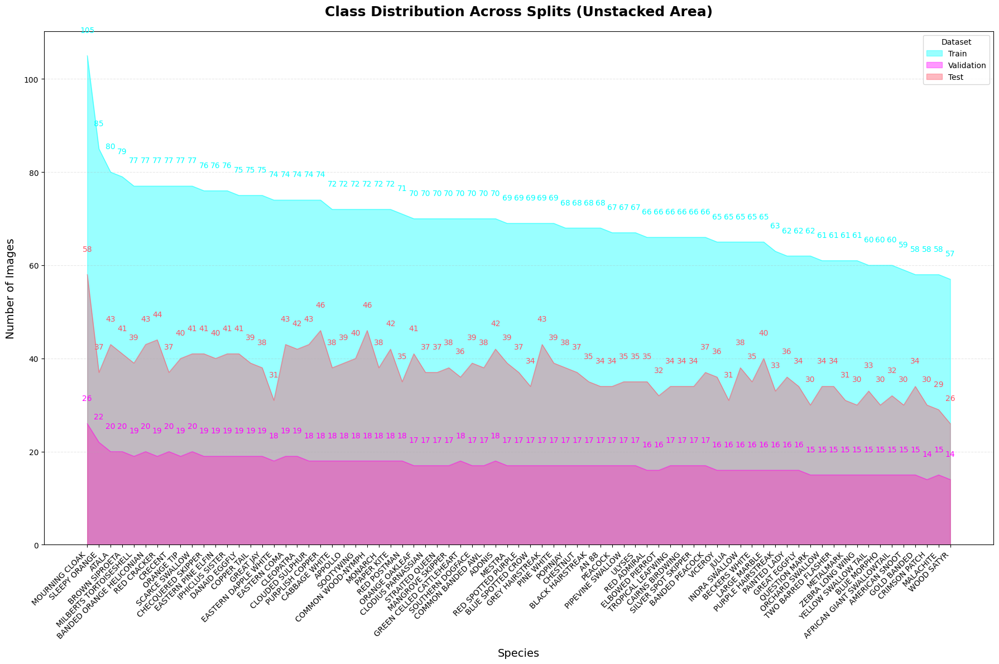

In [194]:
# visualize unstacked area chart -- combined class distributions of images in train-validation-test sets
PALETTE = ['cyan', 'magenta', '#fe5265']
split_order = ['Train', 'Validation', 'Test']

pivot_df = (
    combined_df
    .groupby(['label', 'split'])
    .size()
    .unstack(fill_value=0)
    .reindex(index=class_order, columns=split_order, fill_value=0)
)

plt.figure(figsize=(18, 12))
ax = pivot_df.plot.area(
    color=PALETTE,
    alpha=0.4,
    stacked=False,
    linewidth=1,
    figsize=(18, 12)
)

# value labels at peaks
for split, color in zip(split_order, PALETTE):
    for i, val in enumerate(pivot_df[split]):
        if val > 0:
            ax.text(i, val + 5, f'{int(val):,}',
                    color=color, ha='center', fontsize=10)

plt.xticks(ticks=range(len(class_order)), labels=class_order, rotation=45, ha='right', fontsize=10)
plt.title('Class Distribution Across Splits (Unstacked Area)', pad=20, fontsize=18, fontweight='bold')
plt.ylabel('Number of Images', labelpad=10, fontsize=14)
plt.xlabel('Species', labelpad=10, fontsize=14)
ax.yaxis.grid(True, linestyle='--', alpha=0.3)
plt.legend(title='Dataset')
plt.tight_layout()
plt.show()

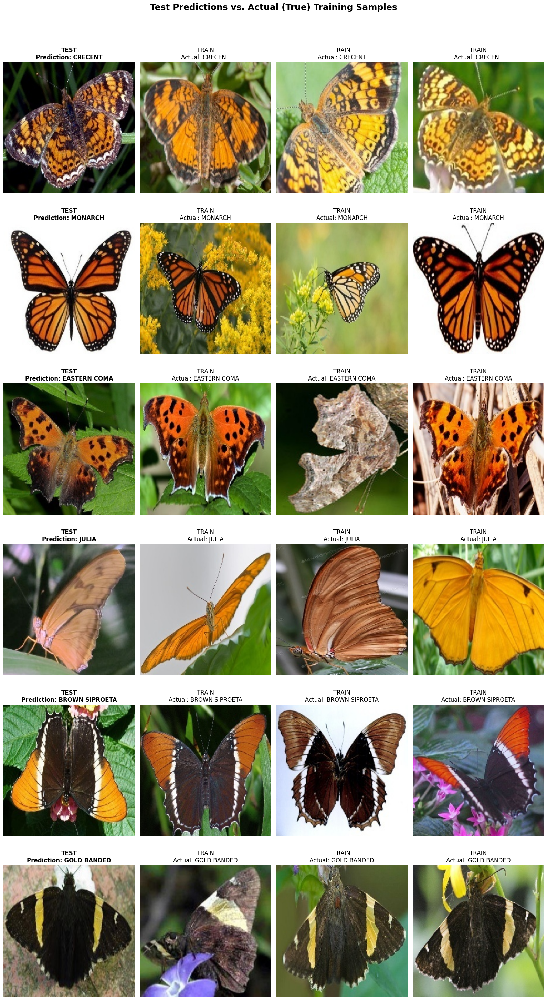

In [195]:
# visualize sample predictions of test images
import random

# showing N random test images, 3 true examples (classified/labeled images from training set) per test image
N = 6
K = 3

indices = random.sample(range(len(test_filenames)), N)
plt.figure(figsize=(4 * (K+1), 5 * N))

for row, idx in enumerate(indices):
    # find in training set the images of this test image's predicted class, selecting K training images to show
    pred_class = predicted_classes[idx]
    class_idx = train_dataset.classes.index(pred_class)
    train_class_indices = [i for i, (path, label) in enumerate(train_dataset.samples) if label == class_idx]
    train_examples = random.sample(train_class_indices, min(K, len(train_class_indices)))
    
    # show test image
    img_path = os.path.join(test_dir, test_filenames[idx])
    img = Image.open(img_path)
    plt.subplot(N, K+1, row*(K+1) + 1)
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"TEST\nPrediction: {pred_class}", fontsize=12, fontweight='bold')
    
    # show K training images
    for j, train_idx in enumerate(train_examples):
        train_img_path, _ = train_dataset.samples[train_idx]
        train_img = Image.open(train_img_path)
        plt.subplot(N, K+1, row*(K+1) + 2 + j)
        plt.imshow(train_img)
        plt.axis('off')
        plt.title(f"TRAIN\nActual: {pred_class}", fontsize=12)
        
plt.suptitle("Test Predictions vs. Actual (True) Training Samples", fontsize=18, fontweight='bold')
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

In [196]:
# save model
# torch.save(model.state_dict(), os.path.join(original_dir, "butterfly_cnn.pth"))
torch.save(model.state_dict(), "butterfly_cnn.pth")